<a href="https://colab.research.google.com/github/jmorand1/ABCMusicLSTM/blob/main/ModelABC_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Generación de Melodías mediante RNN

##Librerías

In [ ]:
!apt install fluidsynth
!cp /usr/share/sounds/sf2/FluidR3_GM.sf2 ./font.sf2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth2 libinstpatch-1.0-2 qsynth
  timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs timidity jackd musescore
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth2 libinstpatch-1.0-2 qsynth
  timgm6mb-soundfont
0 upgraded, 6 newly installed, 0 to remove and 28 not upgraded.
Need to get 126 MB of archives.
After this operation, 157 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/universe amd64 fluid-soundfont-gm all 3.1-5.1 [119 MB]
Get:2 http://archive.ubuntu.com/ubuntu focal/universe amd64 libinstpatch-1.0-2 amd64 1.1.2-2build1 [238 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/universe amd64 timgm6mb-soundfont all 1.3-3 [5,420 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal/universe amd64 libfluidsynth2 amd64 2.1.1-2 [

In [ ]:
import os
import regex as re
import subprocess
import urllib
import numpy as np
import tensorflow as tf
import pandas as pd

from IPython.display import Audio

import matplotlib.pyplot as plt
import time

from IPython import display as ipythondisplay
from string import Formatter

# Import all remaining packages

import functools
from tqdm import tqdm


from music21 import converter
import IPython
from IPython.display import Audio

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Cargando conjunto de datos:
El conjunto de datos consta de miles de canciones, representadas en notación ABC.

In [ ]:
def extract_song_snippet(text):
    pattern = '(^|\n\n)(.*?)\n\n'
    search_results = re.findall(pattern, text, overlapped=True, flags=re.DOTALL)
    songs = [song[1] for song in search_results]
    print("Found {} songs in text".format(len(songs)))
    return songs

In [ ]:
def load_training_data(filepath):
    with open(filepath, "r") as f:
        text = f.read()
    songs = extract_song_snippet(text)
    return songs

filepath = '/content/drive/MyDrive/Análisis Numérico/dataabc.txt'
songs = load_training_data(filepath)

# Print one of the songs
example_song = songs[0]
print("\nSample song: ")
print(example_song)

Found 6957 songs in text

Sample song: 
X: 1
T: The Enchanted Valley
M: 2/4
L: 1/16
B: "O'Neill's 1"
N: "Very slow" "collected by J. O'Neill"
N:
Z: "Transcribed by Norbert Paap, norbertp@bdu.uva.nl"
Z:
K:Gm
G3-A (Bcd=e) | f4 (g2dB) | ({d}c3-B) G2-E2 | F4 (D2=E^F) |
G3-A (Bcd=e) | f4 d2-f2 | (g2a2 b2).g2 | {b}(a2g2 f2).d2 |
(d2{ed}c2) B2B2 | (A2G2 {AG}F2).D2 | (GABc) (d2{ed}c>A) | G2G2 G2z ||
G | B2c2 (dcAB) | G2G2 G3G | B2d2 (gfdc) | d2g2 (g3ga) |
(bagf) (gd)d>c | (B2AG) F-D.D2 | (GABc) d2d2 | (bgfd) cA.F2 |
G2A2 (B2{cB}AG) | A3-G F2-D2 | (GABc) (d2{ed}c>A) | G2G2 G2z2 ||


In [ ]:
len(songs)

6957

Una cosa importante a tener en cuenta es que esta notación de música no solo contiene información sobre las notas que se están tocando, sino que también hay metainformación como el título de la canción, la clave y el tempo.

## Preprocesamiento del conjunto de datos:


### Vectoriza el texto
Crea una representación numérica de este conjunto de datos basado en texto mapeando caracteres a números y mapeando números de regreso a caracteres.

In [ ]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 95 unique characters in the dataset


In [ ]:
### Define numerical representation of text ###

# Create a mapping from character to unique index. 
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. 
idx2char = np.array(vocab)

In [ ]:
pd.DataFrame(char2idx,index=[0])

,\t,\n,,!,"""",#,%,&,',(,...,u,v,w,x,y,z,{,|,},~
0,0,1,2,3,4,5,6,7,8,9,...,85,86,87,88,89,90,91,92,93,94


In [ ]:
print('{')
for char,_ in zip(char2idx, range(11)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))

{
  '\t':   0,
  '\n':   1,
  ' ' :   2,
  '!' :   3,
  '"' :   4,
  '#' :   5,
  '%' :   6,
  '&' :   7,
  "'" :   8,
  '(' :   9,
  ')' :  10,


In [ ]:
import os

with open("/content/drive/MyDrive/Análisis Numérico/dataabc.txt", "r") as input:
    with open("temp.txt", "w") as output:
        # iterate all lines from file
        for line in input:
            # if line starts with substring 'time' then don't write it in temp file
            if not line.strip("\n").startswith('X:'):
                output.write(line)

# replace file with original name
os.replace('temp.txt', 'new.txt')

In [ ]:
def delunlines(lines):
  for i in lines:
    if i == 1:
      txt = "/content/drive/MyDrive/Análisis Numérico/dataabc.txt"
    else:
      txt = "/content/new.txt"
    with open(txt, "r") as input:
      with open("newdata.txt", "w") as output:
          # iterate all lines from file
          for line in input:
              # if line starts with substring 'time' then don't write it in temp file
              if not line.strip("\n").startswith(i):
                  output.write(line)

  # replace file with original name
    os.replace('newdata.txt', 'new.txt')

In [ ]:
lines = ["T:","B:","N:","Z:","O:","H:","I:","S:","R:","C:","%"]
delunlines(lines)

In [ ]:
filepath = '/content/new.txt'
songs = load_training_data(filepath)

# Print one of the songs
example_song = songs[0]
print("\nSample song: ")
print(example_song)

Found 6957 songs in text

Sample song: 
M: 2/4
L: 1/16
K:Gm
G3-A (Bcd=e) | f4 (g2dB) | ({d}c3-B) G2-E2 | F4 (D2=E^F) |
G3-A (Bcd=e) | f4 d2-f2 | (g2a2 b2).g2 | {b}(a2g2 f2).d2 |
(d2{ed}c2) B2B2 | (A2G2 {AG}F2).D2 | (GABc) (d2{ed}c>A) | G2G2 G2z ||
G | B2c2 (dcAB) | G2G2 G3G | B2d2 (gfdc) | d2g2 (g3ga) |
(bagf) (gd)d>c | (B2AG) F-D.D2 | (GABc) d2d2 | (bgfd) cA.F2 |
G2A2 (B2{cB}AG) | A3-G F2-D2 | (GABc) (d2{ed}c>A) | G2G2 G2z2 ||


In [ ]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 88 unique characters in the dataset


In [ ]:
### Define numerical representation of text ###

# Create a mapping from character to unique index. 
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. 
idx2char = np.array(vocab)

In [ ]:
pd.DataFrame(char2idx,index=[0])

,\t,\n,,!,"""",#,&,',(,),...,u,v,w,x,y,z,{,|,},~
0,0,1,2,3,4,5,6,7,8,9,...,78,79,80,81,82,83,84,85,86,87


In [ ]:
print('{')
for char,_ in zip(char2idx, range(11)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))

{
  '\t':   0,
  '\n':   1,
  ' ' :   2,
  '!' :   3,
  '"' :   4,
  '#' :   5,
  '&' :   6,
  "'" :   7,
  '(' :   8,
  ')' :   9,
  '*' :  10,


In [ ]:
### Vectorize the songs string ###

def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output


vectorized_songs = vectorize_string(songs_joined)

In [ ]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'M: 2/4\nL: ' ---- characters mapped to int ----> [42 26  2 18 15 20  1 41 26  2]


In [ ]:
vectorized_songs.shape

(1950045,)

### Crear ejemplos de entrenamiento y objetivos:

Divide el texto en secuencias de ejemplo que se utilizarán durante el entrenamiento. Además, define una secuencia objetivo para cada secuencia de entrada, que se utilizará en el entrenamiento de la RNN para predecir el siguiente carácter. Para cada entrada, el objetivo correspondiente contendrá la misma longitud de texto, pero desplazada un carácter a la derecha. Se utiliza el método de lote (batch) para convertir el flujo de índices de caracteres en secuencias del tamaño deseado.

In [ ]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
    
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]
  
  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

def test_batch_func_types(func, args):
    ret = func(*args)
    assert len(ret) == 2, "[FAIL] get_batch must return two arguments (input and label)"
    assert type(ret[0]) == np.ndarray, "[FAIL] test_batch_func_types: x is not np.array"
    assert type(ret[1]) == np.ndarray, "[FAIL] test_batch_func_types: y is not np.array"
    print("[PASS] test_batch_func_types")
    return True

def test_batch_func_shapes(func, args):
    dataset, seq_length, batch_size = args
    x, y = func(*args)
    correct = (batch_size, seq_length)
    assert x.shape == correct, "[FAIL] test_batch_func_shapes: x {} is not correct shape {}".format(x.shape, correct)
    assert y.shape == correct, "[FAIL] test_batch_func_shapes: y {} is not correct shape {}".format(y.shape, correct)
    print("[PASS] test_batch_func_shapes")
    return True

def test_batch_func_next_step(func, args):
    x, y = func(*args)
    assert (x[:,1:] == y[:,:-1]).all(), "[FAIL] test_batch_func_next_step: x_{t} must equal y_{t-1} for all t"
    print("[PASS] test_batch_func_next_step")
    return True

def test_custom_dense_layer_output(y):
    true_y = np.array([[0.2697859,  0.45750418, 0.66536945]],dtype='float32')
    assert tf.shape(y).numpy().tolist() == list(true_y.shape), "[FAIL] output is of incorrect shape. expected {} but got {}".format(true_y.shape, y.numpy().shape)
    np.testing.assert_almost_equal(y.numpy(), true_y, decimal=7, err_msg="[FAIL] output is of incorrect value. expected {} but got {}".format(y.numpy(), true_y), verbose=True)
    print("[PASS] test_custom_dense_layer_output")
    return True

# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, 10, 2)
if not test_batch_func_types(get_batch, test_args) or \
   not test_batch_func_shapes(get_batch, test_args) or \
   not test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 63 ('e')
  expected output: 31 ('A')
Step   1
  input: 31 ('A')
  expected output: 32 ('B')
Step   2
  input: 32 ('B')
  expected output: 2 (' ')
Step   3
  input: 2 (' ')
  expected output: 61 ('c')
Step   4
  input: 61 ('c')
  expected output: 62 ('d')


## Definición del modelo de RNN

In [ ]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_normal',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [ ]:
def GRU(rnn_units): 
  return tf.keras.layers.GRU(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_normal',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [ ]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
    LSTM(rnn_units),
    #GRU(rnn_units),
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

model = build_model(len(vocab), embedding_dim=512, rnn_units=512, batch_size=64)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (64, None, 512)           45056     
                                                                 
 lstm (LSTM)                 (64, None, 512)           2099200   
                                                                 
 dense (Dense)               (64, None, 88)            45144     
                                                                 
Total params: 2,189,400
Trainable params: 2,189,400
Non-trainable params: 0
_________________________________________________________________


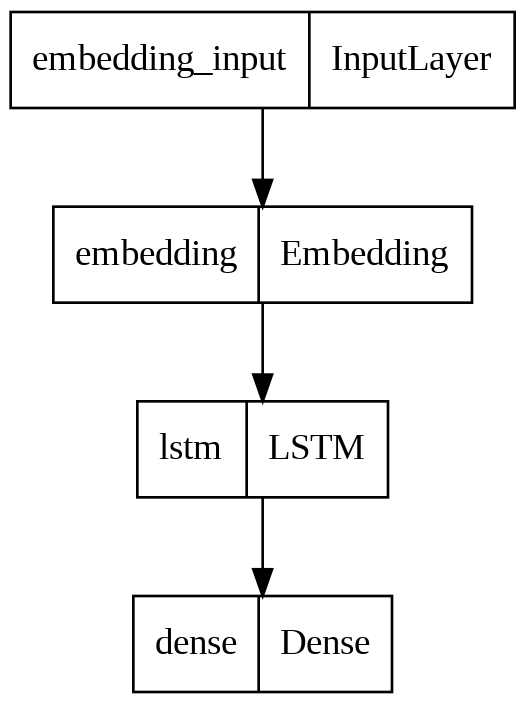

In [ ]:
tf.keras.utils.plot_model(model, dpi=192)

In [ ]:
x, y = get_batch(vectorized_songs, seq_length=200, batch_size=64)
pred = model(x)
print("Input shape:      ", x.shape)
print("Prediction shape: ", pred.shape)

Input shape:       (64, 200)
Prediction shape:  (64, 200, 88)


In [ ]:
y.shape

(64, 200)

In [ ]:
idx2char[x].shape


(64, 200)

### Predicciones del modelo no entrenado

In [ ]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([60, 33, 52, 36, 66,  4,  1, 21, 25,  9, 19, 55, 71, 56, 33, 77, 60,
        3, 18, 81, 75, 61, 76,  8, 30, 65, 68, 75, 47, 86, 54, 75, 32, 32,
       40, 37, 25, 55, 49, 27, 59, 34,  4, 58, 14, 82, 19, 36, 32, 21, 13,
       27,  1, 35, 33, 17, 63, 67, 45, 72, 77,  8, 74, 44,  4, 74, 82, 47,
       66, 33, 79, 82, 73, 22,  2, 44, 22, 45, 40, 87, 61, 59, 11, 35, 42,
       42,  4, 84, 76, 30, 14, 66,  2, 77, 17, 87, 79, 15, 71, 78,  7, 68,
       74, 57, 41, 15, 21, 77, 72, 22, 75, 47, 23, 20, 62, 87, 26, 86, 64,
       75, 31, 79, 56, 28, 83, 67, 84, 32,  1,  2, 16, 13, 66, 16, 53, 79,
       11, 86, 52, 82,  3, 44, 22, 66,  3, 59, 14, 39, 76, 24, 78, 43, 57,
       46, 59, 30, 59, 62, 66, 45,  7, 62, 69, 28,  6, 56, 60, 87,  3, 22,
       46, 83, 73, 41, 78, 30, 58, 18,  8,  4, 61, 33, 40, 35, 33, 43, 63,
       67,  7, 13, 38, 14, 12, 21, 10, 24, 26, 63, 20, 51])

In [ ]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'D"aff fed|aff dff|"G"edd "D"d3|\n"G"bgg dgg|bgg edd|"G"bgg dgg|"C"gee e3|\necc Gcc|"G"DGG Bdd|"D"dff fef|"G"agg g3||\n\nM:6/8\nK:G\n"D7"d2c |"G"Bdd GBB|DGG B,DD|"G"B,DD GBB|"D"GFF F3|\n"D"DFF FAA|"D"Acc cdd|'

Next Char Predictions: 
 'bCWFh"\n59)3\\m]Ctb!2xrcs(@gjrR}[rBBKG9\\T<aD"_.y3FB5-<\nEC1eiPnt(pO"pyRhCvyo6 O6PK~ca+EMM"{s@.h t1~v/mu\'jp^L/5tn6rR74d~:}frAv]=zi{B\n 0-h0Zv+}Wy!O6h!a.Is8uN^Qa@adhP\'dk=&]b~!6QzoLu@_2("cCKECNei\'-H.,5*8:e4V'


## Entrenamiento del modelo

In [ ]:
### Defining the loss function ###

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)


print("Prediction shape: ", pred.shape) 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (64, 200, 88)
scalar_loss:       4.4774613


In [ ]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 6000
batch_size = 10 
seq_length = 300  
learning_rate = 4e-3 

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024

# Checkpoint location: 
import os
#os.mkdir("/kaggle/working/checkpoint")
checkpoint_prefix = os.path.join("/kaggle/working/checkpoint", "my_ckpt")

In [ ]:
def display_model(model):
  tf.keras.utils.plot_model(model,
             to_file='tmp.png',
             show_shapes=True)
  return ipythondisplay.Image('tmp.png')


def plot_sample(x,y,vae):
    plt.figure(figsize=(2,1))
    plt.subplot(1, 2, 1)

    idx = np.where(y==1)[0][0]
    plt.imshow(x[idx])
    plt.grid(False)

    plt.subplot(1, 2, 2)
    _, _, _, recon = vae(x)
    recon = np.clip(recon, 0, 1)
    plt.imshow(recon[idx])
    plt.grid(False)

    plt.show()



class LossHistory:
  def __init__(self, smoothing_factor=0.0):
    self.alpha = smoothing_factor
    self.loss = []
  def append(self, value):
    self.loss.append( self.alpha*self.loss[-1] + (1-self.alpha)*value if len(self.loss)>0 else value )
  def get(self):
    return self.loss

class PeriodicPlotter:
  def __init__(self, sec, xlabel='', ylabel='', scale=None):

    self.xlabel = xlabel
    self.ylabel = ylabel
    self.sec = sec
    self.scale = scale

    self.tic = time.time()

  def plot(self, data):
    if time.time() - self.tic > self.sec:
      plt.cla()

      if self.scale is None:
        plt.plot(data)
      elif self.scale == 'semilogx':
        plt.semilogx(data)
      elif self.scale == 'semilogy':
        plt.semilogy(data)
      elif self.scale == 'loglog':
        plt.loglog(data)
      else:
        raise ValueError("unrecognized parameter scale {}".format(self.scale))

      plt.xlabel(self.xlabel); plt.ylabel(self.ylabel)
      ipythondisplay.clear_output(wait=True)
      ipythondisplay.display(plt.gcf())

      self.tic = time.time()


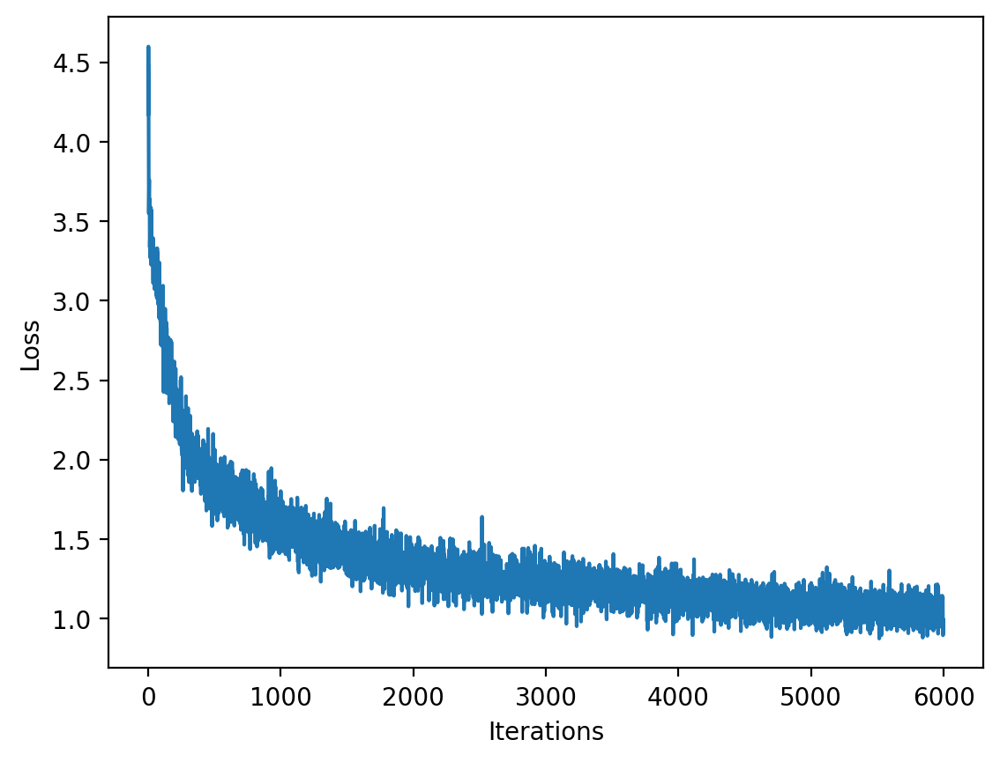

100%|██████████| 6000/6000 [09:59<00:00, 10.00it/s]


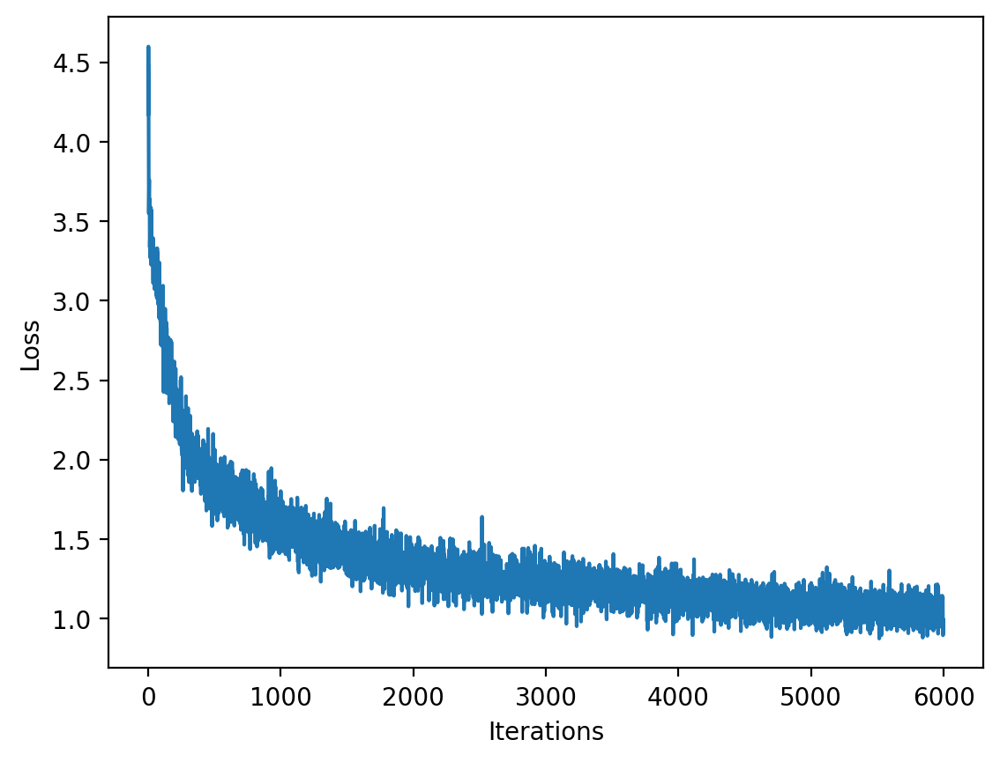

In [ ]:
### Define optimizer and training operation ###

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

optimizer = tf.keras.optimizers.AdamW(learning_rate,weight_decay=0.00003)

@tf.function
def train_step(x, y): 
  with tf.GradientTape() as tape:
  
    
    y_hat = model(x) 
      
    
    loss = compute_loss(y, y_hat) 
  grads = tape.gradient(loss, model.trainable_variables) 
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

history = []
plotter = PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

In [ ]:
  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)

##Generación de canciones

In [ ]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  input_eval = [char2idx[s] for s in start_string]
  print(input_eval)
  input_eval = tf.expand_dims(input_eval, 0)
  print("\n",input_eval)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      
      predictions = model(input_eval)
      
      predictions = tf.squeeze(predictions, 0)
      
      
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      
      input_eval = tf.expand_dims([predicted_id], 0)
      
      
      text_generated.append(idx2char[predicted_id]) 
    
  return (start_string + ''.join(text_generated))

In [ ]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1) 
# Restore the model weights for the last checkpoint after training
model.load_weights(checkpoint_prefix)
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (1, None, 256)            22528     
                                                                 
 lstm_2 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_2 (Dense)             (1, None, 88)             90200     
                                                                 
Total params: 5,359,704
Trainable params: 5,359,704
Non-trainable params: 0
_________________________________________________________________


In [ ]:
generated_text =[]
generated_songs =[]
del(generated_text)
del(generated_songs)
generated_text = generate_text(model, start_string="M:C\nL:1/8\nK:Am\n", generation_length=10000) 

100%|██████████| 10000/10000 [01:27<00:00, 114.82it/s]


In [ ]:
generated_songs = extract_song_snippet(generated_text)

Found 29 songs in text


In [ ]:
def dispsongs(songs):
  for i in songs:
    print("\nCANCIÓN EN NOTACIÓN ABC\n")
    cadena = i
    print(cadena,"\n")
    cadena = cadena.replace("|", "")

    print("AUDIO\n")

    s =  converter.parse(cadena, format='abc')
    s.write('midi', fp='output.mid')
    !fluidsynth -ni font.sf2 "output.mid" -F output.wav -r 44100
    IPython.display.display(Audio('output.wav'))

In [ ]:
dispsongs(generated_songs)


CANCIÓN EN NOTACIÓN ABC

M:C
L:1/8
K:Am
cBA|GcE ECC|E2A A2g|agf g2:|
|:E|e2c e2c|B2B Bcd|c2A GED|E3 B2A|!
B2e e2e|B2B BAG|efe e2f|g3 fed:|!
efe a2e|ada e2a|g2e d/2B/2A/2B/2|\
"G"g/2d/2A/2G/2 "G"B/2A/2G/2B/2|\
"G"g/2d/2B/2A/2G/2A/2 B/2A/2G/2B/2|"C"c/2B/2A/2B/2c/2A/2|"G"G3/2"A7"A/2B/2c/2A/2|
"D"d3/2c/2d|a/2g/2f/2d/2|"A"e/2c/2AG/2A/2|"G"GB|"D"A/2F/2D/2F/2 A/2B/2A/2G/2|
"G""G"b3/2a/2 g/2e/2f/2e/2|"G"dd "D"d2|| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC


M:4/4 gdg|(e2:| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC

M:4/4 gdg|(e2:| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC

M:6/8
K:G
d|g z d BAB|G2 g f gfd|ecA ABG|
|E>FA B>AF EFD|G>EE E2e|e>^df edB-|AFD D2:|
a/g/|F>af gfe|f>AF (F/f/)|FEF D2 F|\
G>AG BdB|A>BA A3|A2 d d2:| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC


M:6/8
L:1/8
K:D
A|d2 A BAF|ADD B2d|cAF G2 A|Bcd A2 A|
A2 d fga|c2 c c2 c|B2 B B2 d|cBA G2 ^F|"G"GBe dBd|
"Em"gag geg|"Em"fed "A"cde|"D"faf "A"ece|"D"d3 -d3|\
"A7"cBc "A7"ABc|
"D"def A2A|"D"dcd "G"edB|"D"d3 -d2
|:d|"D"f2g a2b|"D"agf "G"gba|"G"bge "A7"d2b|"D"aba agf|
"Em"e2g "A7"f2e|"D"dfa "A7"gfe|"D"d2f "A7"a2g|"D"fdd d2:|
P:B
f/2g/2|"D"aba "A"gec|cBc ace|"D"fdc "E7"B3|"D"AAA fAa|
"D"agf "A7"ede "D"fg|"D"agf "A"ecA EAc|"D"fed "A"A2c|"E7"Bed "A"c2:| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC

M:6/8
L:1/8
K:D
A|d2 A BAF|ADD B2d|cAF G2 A|Bcd A2 A|
A2 d fga|c2 c c2 c|B2 B B2 d|cBA G2 ^F|"G"GBe dBd|
"Em"gag geg|"Em"fed "A"cde|"D"faf "A"ece|"D"d3 -d3|\
"A7"cBc "A7"ABc|
"D"def A2A|"D"dcd "G"edB|"D"d3 -d2
|:d|"D"f2g a2b|"D"agf "G"gba|"G"bge "A7"d2b|"D"aba agf|
"Em"e2g "A7"f2e|"D"dfa "A7"gfe|"D"d2f "A7"a2g|"D"fdd d2:|
P:B
f/2g/2|"D"aba "A"gec|cBc ace|"D"fdc "E7"B3|"D"AAA fAa|
"D"agf "A7"ede "D"fg|"D"agf "A"ecA EAc|"D"fed "A"A2c|"E7"Bed "A"c2:| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC

M:6/4
L:1/8
K:Em
z|"G"g3/2f/4g/4 "A7"a|"D"a3/2f/2 a/2f/2a/2a/2|"G"b/2a/2g/2a/2 "A7"bc'|
"D"d'd' "D"fa/2g/2|"D"ff/2d/2 "A"c/2A/2c/2c/2|"D"df d:| 

AUDIO

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'output.wav'..



CANCIÓN EN NOTACIÓN ABC

M:4/4
L:1/4
K:D
f/2e/2|"D"d/2B/2d/2B/2 "A7"c/2A/2d/2e/2|"D"f/2e/2d/2B/2 "E7"B/2G/2F/2G/2|
"D"A/2B/2A/2F/2 A/2a/2g/2f/2|"Em"e/2f/2e/2d/2 "A"B/2A/2(3A/2A/2c/2|"Em"B/2e/2B/2e/2 "A7"B/2e/2f/2g/2|\
"B7"f/2b/2a/2f/2 "E7"g/2e/2d/2B/2|
"D"AF/2A/2 D/2F/2A/2F/2|"Bm"E/2dB/2 "E7"c/2d/2e/2f/2|"A"e/2f/2g/2f/2 ee:|
"A"a/2b/2a/2g/2 A/2c/2e/2c/2|"A"e/2f/2e/2d/2 cB/2c/2|"A"A/2A/2A/2c/2 e/2d/2c/2e/2|\
"C"=g/2f/2e/2g/2 "A"ce|
"Bm"b/2a/2g/2B/2 g/2B/2f/2b/2|b/2B/2a/2B/2 g/2B/2f/2B/2|\
"E"fe "A"ae/2g/2:|
 [2"A"B/2A/2(3A/2B/2c/2 "A"AA/2B/2|"Bm"B/2c/2d/2c/2 "E"B/2A/2G/2B/2|"A"A/2B/2c/2d/2 e/2g/2f/2e/2|"D""b"d/2B/2(c/4B/4) A/2c/2|"G"B/2A/2B/2B/2 -B/2A/2G|"Am"E/2AE/2 "E7"EB/2c/2|
"A"AA/2c/2 B/2A/2F/2E/2|"F#"Bd B/2c/2d/2A/2|\
"E7"B/2e/2e/2d/2 B2|
"D"AF Ac|"Bm"BB/2B/2 Bd/2c/2|"E"Bc/2d/2 e/2d/2c/2B/2|
"D"A/2B/2d/2e/2 "G"d/2B/2B/2B/2|"A7"AA Af/2g/2|
"D"a/2e/2 d/2A/2F/2A/2 d/2A/2F/2A/2|\
"D"df/2d/2 A/2f/2d/2f/2|"Em"gb ge/2f/2|"A7"g/2e/2c/2e/2 "D"d::
"A"a/2a/2g/2f/2 ea|"A"ee a/2f/2e/2c/2|\
"B